# 1 Análise de suicidios - Usando gráficos e mapas com matplotlib e folium



## 1.1 Caso de estudo - Visão geral da taxa de suicídio de 1985 to 2016
  Dado o crescimento nos casos de identificação de depressão nos últimos anos, decidi ir atrás de um dataset que mostrasse uma visão geral indices de suícidios no mundo para trabalhar com gráficos e mapas usando matplotlib e folium em python.

## 1.2 Conjunto de dados
Para realizar a análise utilizei um base de dados do [kaggle](https://www.kaggle.com/russellyates88/suicide-rates-overview-1985-to-2016) e para facilitar a nossa vida, um geojson contendo os países no [repositório](https://github.com/johan/world.geo.json/blob/master/countries.geo.json?short_path=afdfc39) do github

Mas vamos lá! Primeiramente vamos importar todas as nossas dependências abaixo. Vamos precisar instalar o folium que por padrão não vem instalado no colab.

In [206]:
# Install the latest release
!pip install folium==0.8.2

In [0]:
# dependências
import pandas as pd

from google.colab import files
from tqdm import tqdm


## 1.3 Analisando o dataset
Vamos ler nossa base utilizando para isso o pandas e depois vamos obter as informações do formato do dataset e quais são seus campos


In [227]:
# leitura da base de dados
suicide_rate = pd.read_csv('suicide-rates-overview-1985-to-2016.csv')

# informações sobre o dataframe
print(suicide_rate.shape)
suicide_rate.info()

(27820, 12)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27820 entries, 0 to 27819
Data columns (total 12 columns):
country               27820 non-null object
year                  27820 non-null int64
sex                   27820 non-null object
age                   27820 non-null object
suicides_no           27820 non-null int64
population            27820 non-null int64
suicides/100k_pop     27820 non-null float64
country_year          27820 non-null object
HDI_for_year          8364 non-null float64
gdp_for_year_($)      27820 non-null object
gdp_per_capita_($)    27820 non-null int64
generation            27820 non-null object
dtypes: float64(2), int64(4), object(6)
memory usage: 2.5+ MB


Note que o dataset não possui dados de todos os países, mais a frente no notebook mostraremos os paises faltantes em um mapa.
Aqui podemos ver que a coluna **HDI for year** possui muito dados faltantes e a **country-year** é desnecessária por já existir uma coluna referente ao ano, então vamos removê-las

In [0]:
# Removendo colunas desnecessárias
suicide_rate = suicide_rate.drop(['country_year', 'HDI_for_year', 'gdp_for_year_($)','gdp_per_capita_($)'], axis=1)

Novamente imprimindo as informações do dataset

In [230]:
# imprimindo as primeira linhas do dataframe

print(suicide_rate.shape)
suicide_rate.info()
print(suicide_rate.head())

(27820, 8)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27820 entries, 0 to 27819
Data columns (total 8 columns):
country              27820 non-null object
year                 27820 non-null int64
sex                  27820 non-null object
age                  27820 non-null object
suicides_no          27820 non-null int64
population           27820 non-null int64
suicides/100k_pop    27820 non-null float64
generation           27820 non-null object
dtypes: float64(1), int64(3), object(4)
memory usage: 1.7+ MB
   country  year     sex  ... population  suicides/100k_pop       generation
0  Albania  1987    male  ...     312900               6.71     Generation X
1  Albania  1987    male  ...     308000               5.19           Silent
2  Albania  1987  female  ...     289700               4.83     Generation X
3  Albania  1987    male  ...      21800               4.59  G.I. Generation
4  Albania  1987    male  ...     274300               3.28          Boomers

[5 rows x 8 co

## 2 Agrupando dados e Plotango gráfico
Agora podemos agrupar os dados para geração dos nossos gráficos e dos mapas. Assim vamos separar nos seguintes dados
- Taxa por faixa etária
- Taxa por ano
- Taxa por sexo
- Taxa por país (de todos os anos )

Para isso vamos utilizar o groupby e matplotlib e seaborn para plotagem dos gráficos e para os mapas utilizar o folium. Vamos começar pelo agrupamento por pais e gerar um gráfico do Top 10.

In [232]:
# Agrupando por pais e número de suicidios
rate_countries = pd.DataFrame(suicide_rate['suicides_no'].groupby(suicide_rate['country']).sum())

# Ordenando pelo número de suicídios
rate_countries = rate_countries.sort_values(by="suicides_no", ascending=False)

# resetando o indice
rate_countries = rate_countries.reset_index()

# 10 primeiros
top10_by_country = rate_countries.head(10)
print(top10_by_country)

              country  suicides_no
0  Russian Federation      1209742
1       United States      1034013
2               Japan       806902
3              France       329127
4             Ukraine       319950
5             Germany       291262
6   Republic of Korea       261730
7              Brazil       226613
8              Poland       139098
9      United Kingdom       136805


E o gráfico de histograma com os 10 primeiros

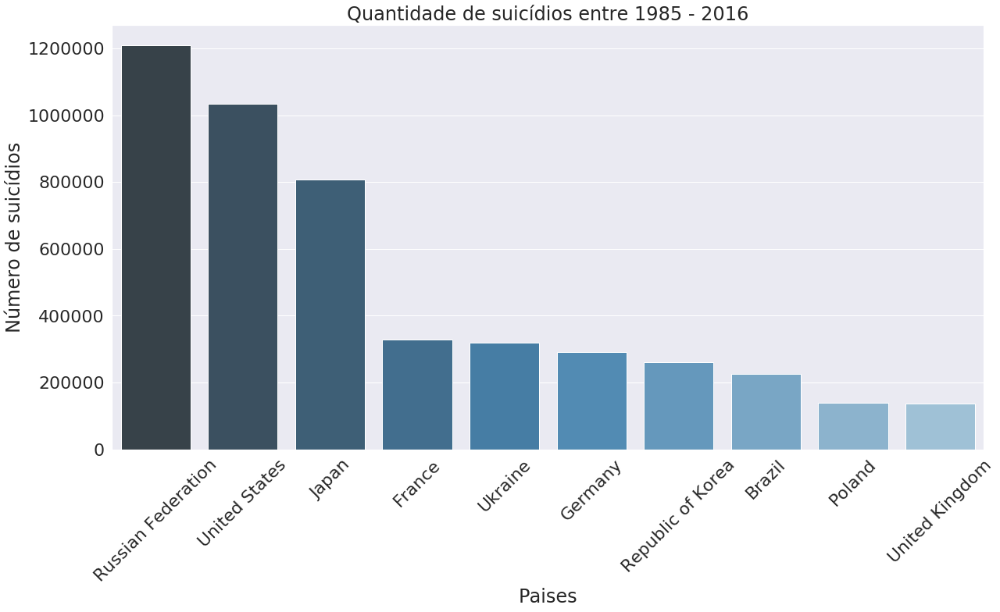

<Figure size 432x288 with 0 Axes>

In [238]:
# Gerando o gráfico do top10 por pais

# importando pyplot e seaborn
import matplotlib.pyplot as plt
import seaborn as sns

# Criando figura
figure = plt.figure(figsize=(20, 10))

# Título do gráfico
plt.title("Quantidade de suicídios entre 1985 - 2016")

# tipo de gráfico e passando dados para exibição
sns.barplot(y='suicides_no', x='country', data=top10_by_country, palette="Blu")

# nomes de coluna e linha
plt.ylabel('Número de suicídios')
plt.xlabel('Paises')

# rotação dos nomes dos paises, para melhor visualização 
plt.xticks(rotation=45)

# exibe o gráficot
plt.show()    

plt.savefig('top10-country', dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format=None,
        transparent=False, bbox_inches=None, pad_inches=0.1,
        frameon=None, metadata=None)

Vamos agora fazer um agrupamento para analisarmos a taxa de suicidios por ano


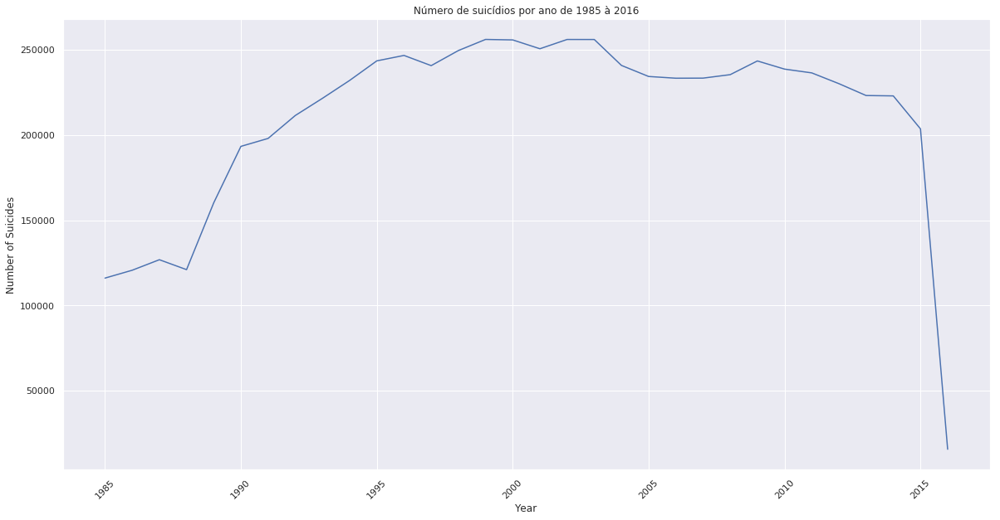

In [251]:
# Agrupando por ano e número de suicídios
rate_years = pd.DataFrame(suicide_rate['suicides_no'].groupby(suicide_rate['year']).sum())

# ordenando pelo maior numero de suicidios
rate_years = rate_years.reset_index()

# criando figura
figure = plt.figure(figsize=(20, 10))

# criando gráfico
sns.set(style="darkgrid")
sns.lineplot(y='suicides_no', x='year', data=rate_years, palette="ch:.25")

# Labels
plt.ylabel("Número de suicídios")
plt.xlabel("Year")
plt.title("Número de suicídios por ano de 1985 à 2016")

# rotação dos nomes dos paises, para melhor visualização 
plt.xticks(rotation=45)

# exibindo gráfico
plt.show()

E por último vamos analisar a geração que possui faixa mais crítica de incidência de suicídios

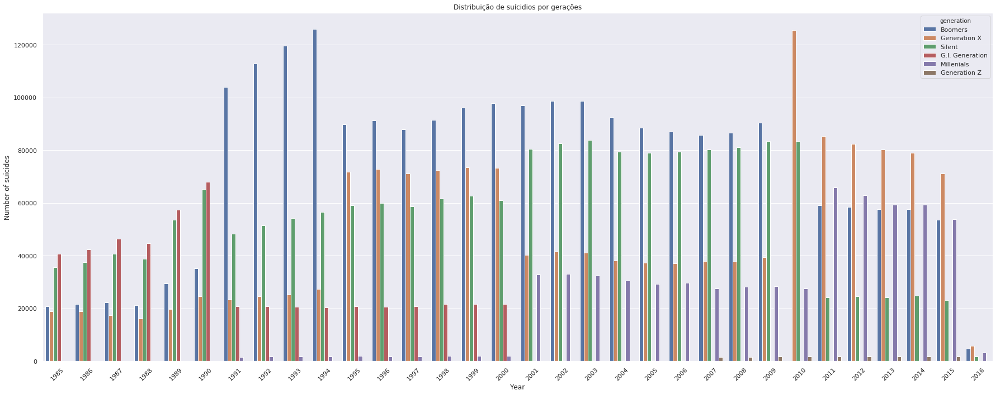

In [258]:
# Agrupando por geração
rate_generation = pd.DataFrame(suicide_rate['suicides_no'].groupby([suicide_rate['generation'], suicide_rate['year']]).sum())

# ordenando pelo número de suicídios
rate_generation = rate_generation.reset_index().sort_values(by='suicides_no', ascending=False)

# criando figura e gráfico
fig = plt.figure(figsize=(25, 10))
sns.barplot(y='suicides_no', x='year', hue='generation', data=rate_generation, palette='deep')

# lables
plt.title("Distribuição de suícidios por gerações")
plt.ylabel('Number of suicides')
plt.xlabel('Year')

# rotação eixo-x
plt.xticks(rotation=45)

# exibe gráfico
plt.tight_layout()

## 3 Criando mapas com folium

In [260]:
from branca.colormap import linear

# colormap yellow or red
colormap = linear.YlOrRd_09.scale(
    rate_countries.suicides_no.min(),
    rate_countries.suicides_no.max())

colormap.caption="Suicide in world from 1985 to 2016"
print(colormap(5000.0))

colormap


#ffffcb


In [0]:
import json

# leitura do geojson dos países
geojson_mundi = json.load(open('countries.geojson'))

In [264]:
# geojson para os paises que estão no nosso dataset
filtered_geojson = {
  "type": "FeatureCollection",
  "features": []
}

# lista de paises que estão no dataset
data_country = list(rate_countries.country)

# adicionar os nomes que tem a mesma correspondência
in_list = []

# list para identificar inconsistencias
notin = []

# acessando geojson dos paises
for country in geojson_mundi['features']:
  # recuperando o nome do pais
  name_aux = country['properties']['ADMIN']
  
  # adicionando na lista os nomes com correspondência
  if(name_aux in data_country):
    in_list.append(name_aux)

# quantos paises estão corretos
print(len(in_list))

# verificando os paises com nomes diferentes que precisam ser modificados
for country in data_country:
  if(not(country in aux)):
    notin.append(country)
    
# os que divergirão
print(len(notin))
print(notin)

# com isso podemos fazer uma renomeação antes de realizar a filtragem de fato

93
8
['Russian Federation', 'United States', 'Republic of Korea', 'Serbia', 'Saint Vincent and Grenadines', 'Bahamas', 'Cabo Verde', 'Macau']


In [265]:
# rename columns
rate_countries.loc[rate_countries.country == "Russian Federation", 'country'] = "Russia"
rate_countries.loc[rate_countries.country == "United States", 'country'] = "United States of America"
rate_countries.loc[rate_countries.country == "Republic of Korea", 'country'] = "South Korea"
rate_countries.loc[rate_countries.country == "Serbia", 'country'] = "Republic of Serbia"
rate_countries.loc[rate_countries.country == "Saint Vincent and Grenadines", 'country'] = "Saint Vincent and the Grenadines"
rate_countries.loc[rate_countries.country == "Bahamas", 'country'] = "The Bahamas"
rate_countries.loc[rate_countries.country == "Cabo Verde", 'country'] = "Cape Verde"
rate_countries.loc[rate_countries.country == "Macau", 'country'] = "Macao S.A.R"

# atribuindo a coluna country como indice (isso vai nos ajudar na hora de criar o mapa)
rate_countries.set_index('country', inplace=True)

# retirando o nome da coluna de indices
rate_countries.index.name = None

# reatribuindo os dados da coluna nome (isso nos ajuda com a captura dos nomes para inserir no mapa)
rate_countries['country'] = rate_countries.index

# exibe os 10 primeiros
print(rate_countries.head(10))

                          suicides_no                   country
Russia                        1209742                    Russia
United States of America      1034013  United States of America
Japan                          806902                     Japan
France                         329127                    France
Ukraine                        319950                   Ukraine
Germany                        291262                   Germany
South Korea                    261730               South Korea
Brazil                         226613                    Brazil
Poland                         139098                    Poland
United Kingdom                 136805            United Kingdom


In [182]:
outside = []
data_country = list(rate_countries.country)
for country in geojson_mundi['features']:
  name_aux = country['properties']['ADMIN']
  if(not(name_aux in data_country)):
    outside.append(name_aux)
    
print(len(outside))

154


In [183]:
# filtrando os paises presentes no dataset original
def filter_countries(features):
  filtered_geojson = {
    "type": "FeatureCollection",
    "features": []
  }
  
  for country in features:
    name_aux = country['properties']['ADMIN']
    if(name_aux in data_country):
      country['properties']['suicides_no'] = str(rate_countries.loc[name_aux, 'suicides_no'])
      filtered_geojson['features'].append(country)
      
  return filtered_geojson

if(len(filtered_geojson['features']) < 101):
  filtered_geojson = filter_countries(geojson_mundi['features'])

len(filtered_geojson['features'])

101

In [184]:
import folium

from folium.plugins import MiniMap


# Criando mapa com folium e colomap
mp = folium.Map(
  location=[30,0],
  tiles='openstreetmap',
  zoom_start=2
)
  
folium.GeoJson(filtered_geojson,
              name='Number of suicides',
              style_function=lambda country: {'fillColor': colormap(rate_countries.loc[country['properties']['ADMIN'], 'suicides_no']),
                                              'color': 'black',
                                              'weight': 2,
                                              'fillOpacity':0.8},
              tooltip=folium.GeoJsonTooltip(fields=['ADMIN', "suicides_no"],
                                           aliases=['Country:','Nº Suicides:'],
                                           localize=True)
              ).add_to(mp)  


# create and add a minimap
minimap = MiniMap()
mp.add_child(minimap)

# layer control
folium.LayerControl().add_to(mp)

# adicionando o colormap
colormap.add_to(mp)

mp.save('suicide.html')
# show the map
mp

In [0]:
files.download('suicide.html') 

In [186]:
outside_geojson = {
  "type": "FeatureCollection",
  "features": []
}

# filtrando os paises presentes no dataset original
def filter_countries(features):
  filtered_geojson = {
    "type": "FeatureCollection",
    "features": []
  }
  
  for country in features:
    name_aux = country['properties']['ADMIN']
    if(name_aux in outside):
#       country['properties']['suicides_no'] = str(rate_countries.loc[name_aux, 'suicides_no'])
      filtered_geojson['features'].append(country)
      
  return filtered_geojson

if(len(outside_geojson['features']) <= 0):
  outside_geojson = filter_countries(geojson_mundi['features'])

len(outside_geojson['features'])

154

In [266]:
# Paises que não estão no dataset 
outside_map = folium.Map(
  location=[30,0],
  tiles='openstreetmap',
  zoom_start=2
)

folium.GeoJson(outside_geojson).add_to(outside_map)

outside_map

In [0]:
outside_map.save('outside_map.html')
# show the map
hfiles.download('outside_map.html')

### HeatMap
Exibindo a taxa de suicídio por 100k habitantes